# MPA 5830 - Module 06 (Fall 2021)

In the last module we started building some visualizations in order to answer specific substantive questions. In this module we will look at generating more advanced graphics that have annotations, combine several graphics into one, build some interactive graphics, and also do some mapping. 

# Combining Plots with `{patchwork}`
Often you have to combine and place multiple graphics into a single canvas. There are a few ways to do this but the easiest way is that offered by the `{patchwork}` package. Let us use the `diamonds` data for this section, a data frame with 53940 rows and 10 variables:

| Variable | Description |
| :-- | :-- |
| price |  price in US dollars (\$326--\$18,823) |
| carat | weight of the diamond (0.2--5.01) |
| cut | quality of the cut (Fair, Good, Very Good, Premium, Ideal) |
| color | diamond colour, from D (best) to J (worst) |
| clarity | a measurement of how clear the diamond is (I1 (worst), SI2, SI1, VS2, VS1, VVS2, VVS1, IF (best)) |
| x | length in mm (0--10.74) |
| y | width in mm (0--58.9) |
| z | depth in mm (0--31.8) |
| depth | total depth percentage = z / mean(x, y) = 2 * z / (x + y) (43--79) |
| table | width of top of diamond relative to widest point (43--95) |

## The Basics 

To combine multiple plots, we need to save `each plot` with a unique name. I am calling them `p1`, `p2`, etc. Let us generate four plots, each different from all others. 

In [1]:
# install.packages(c('patchwork', 'tidylog'))

In [2]:
library(patchwork)
library(tidyverse)
library(tidylog)

── Attaching packages ─────────────────────────────────────── tidyverse 1.3.1 ──

✔ ggplot2 3.3.5     ✔ purrr   0.3.4
✔ tibble  3.1.6     ✔ dplyr   1.0.7
✔ tidyr   1.1.4     ✔ stringr 1.4.0
✔ readr   2.1.0     ✔ forcats 0.5.1

── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()


Attaching package: ‘tidylog’


The following objects are masked from ‘package:dplyr’:

    add_count, add_tally, anti_join, count, distinct, distinct_all,
    distinct_at, distinct_if, filter, filter_all, filter_at, filter_if,
    full_join, group_by, group_by_all, group_by_at, group_by_if,
    inner_join, left_join, mutate, mutate_all, mutate_at, mutate_if,
    relocate, rename, rename_all, rename_at, rename_if, rename_with,
    right_join, sample_frac, sample_n, select, select_all, select_at,
    select_if, semi_join, slice, slice_head, slice_max, slice_min,
    slice_sample, slice_tail, summarise, summa

In [3]:
options(repr.plot.width = 16, repr.plot.height = 8)

ggplot() +
  geom_bar(data = diamonds,
           aes(x = cut, fill = cut)
           ) +
  labs(x = "Cut of the Diamond", y = "Frequency") +
  theme(legend.position = "none") -> p1

In [4]:
ggplot() +
  geom_bar(data = diamonds,
           aes(x = color, fill = color)
           ) +
  labs(x = "Color of the Diamond", y = "Frequency") +
  theme(legend.position = "none") -> p2

In [5]:
ggplot() +
  geom_point(data = diamonds,
           aes(x = carat, y = price, color = cut)
           ) +
  labs(x = "Weight of the Diamond", y = "Price of the Diamond", color = "") +
  theme(legend.position = "bottom") -> p3

In [6]:
ggplot() +
  geom_boxplot(data = diamonds,
           aes(x = price, y = clarity, fill = cut)
           ) +
  labs(y = "Clarity of the Diamond", x = "Price of the Diamond", fill = "") +
  theme(legend.position = "bottom") -> p4

Let us see each plot in turn so we know what they look like.

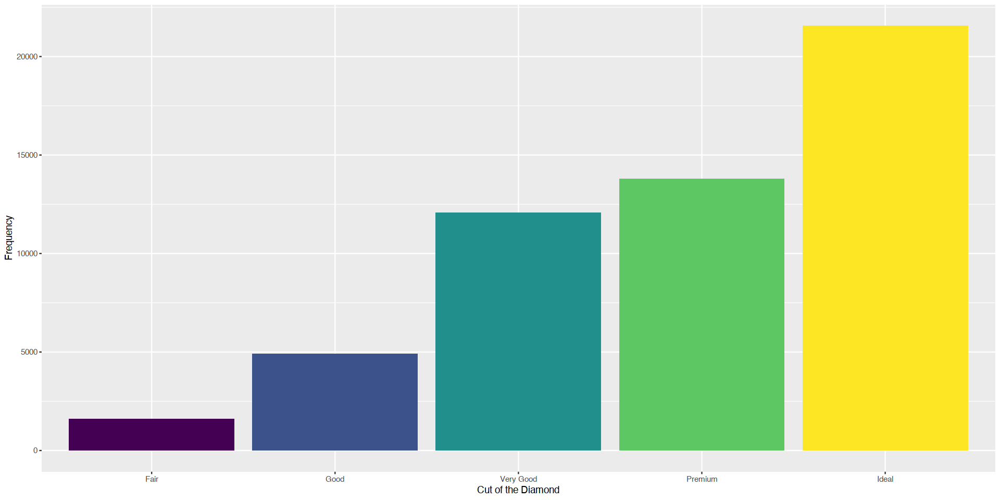

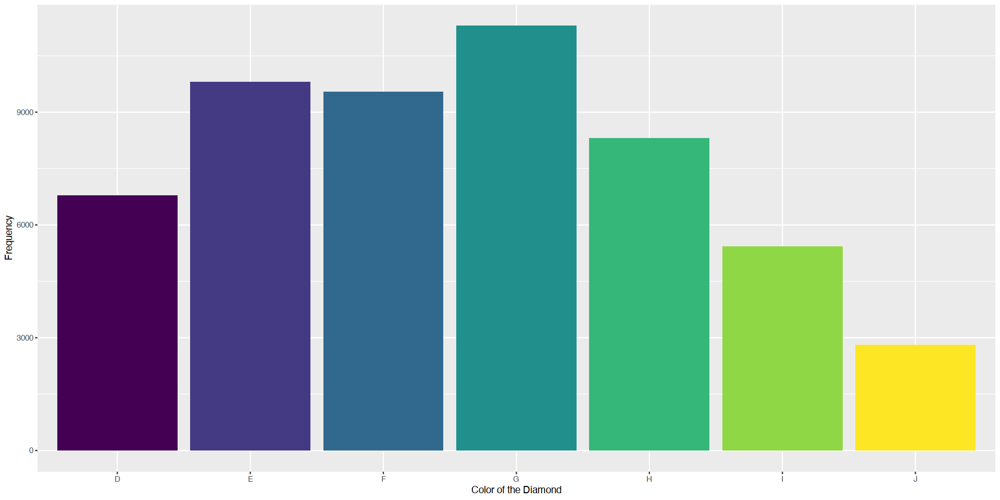

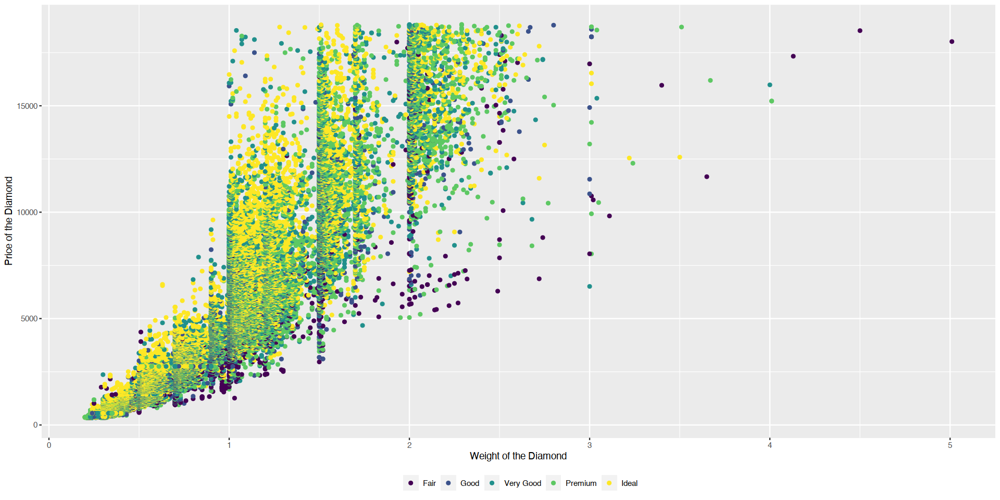

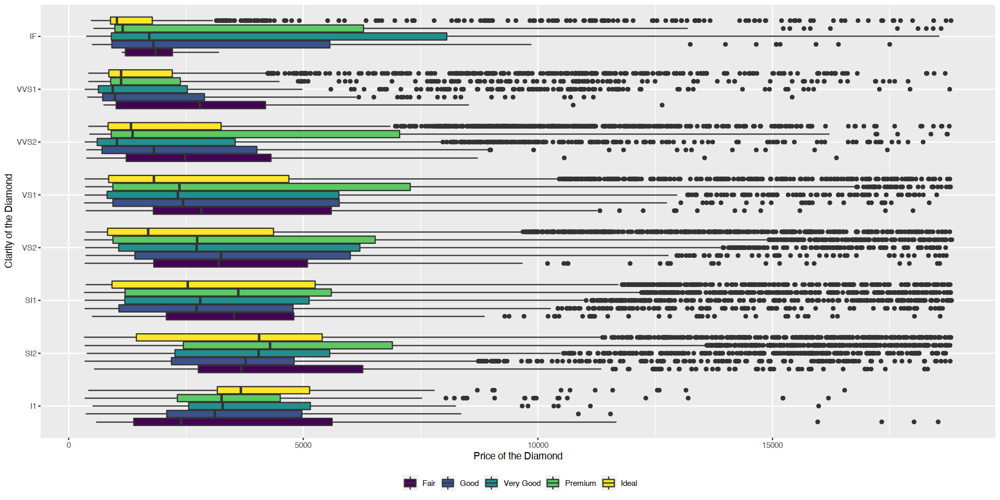

In [7]:
p1; p2; p3; p4

Now we combine p1 through p3 on a single canvas

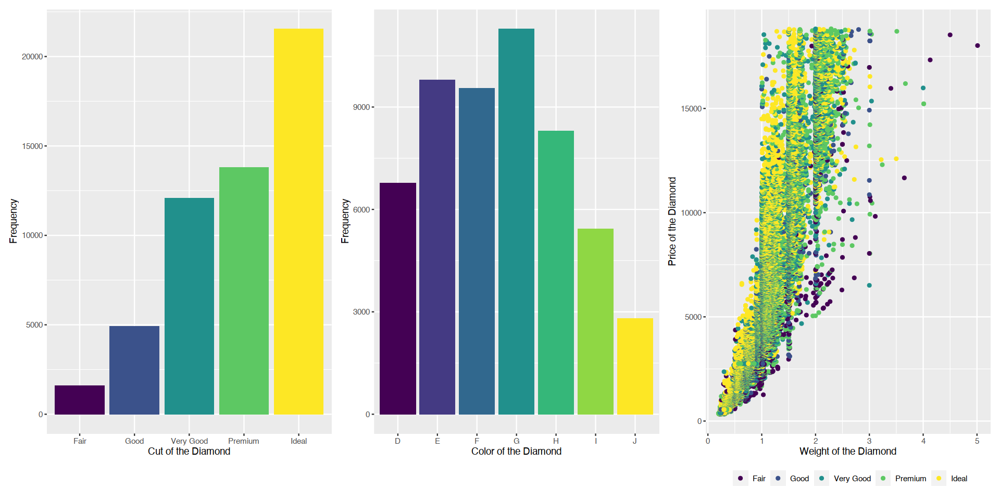

In [8]:
p1 + p2 + p3 

Notice the default layout here: `p1 + p2 + p3` gives us the plots all in a row. 

But you may have other plans, for example, to put the scatterplot in a row all its own. 

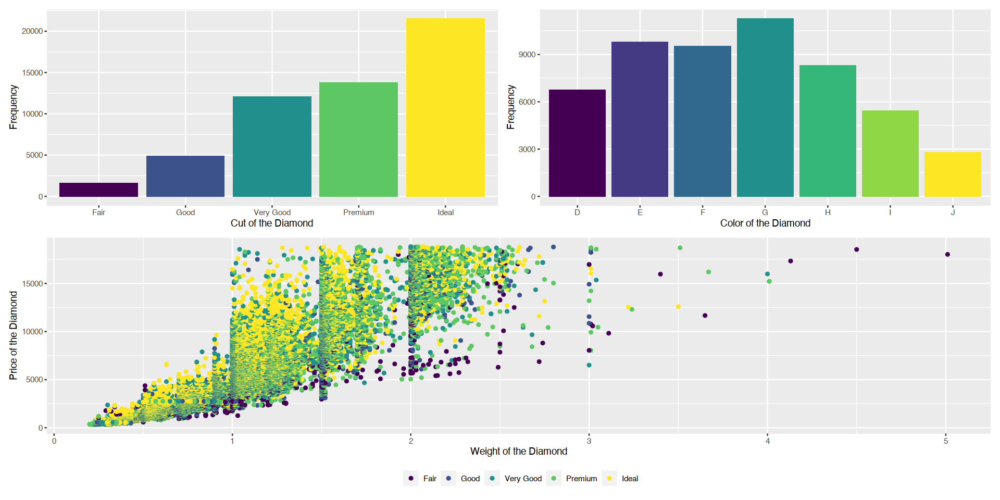

In [9]:
(p1 + p2) / p3

Now we have `p3` in the second row, all by itself. Note that this was achieved via the `/` operator and by coercing `p1` and `p2` into a single row via `(p1 + p2)`. 

What if we used `|` instead?

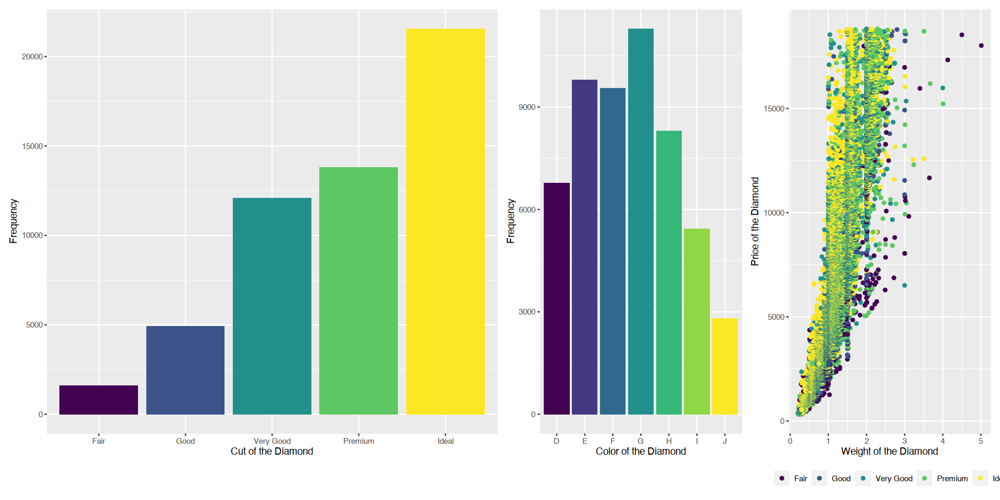

In [10]:
p1 | (p2 + p3)

You ended up with two columns, the first containing only `p1` and the second containing `p2` and `p3`. 

Note the difference between `|` and `/`. For example, note the following setup:

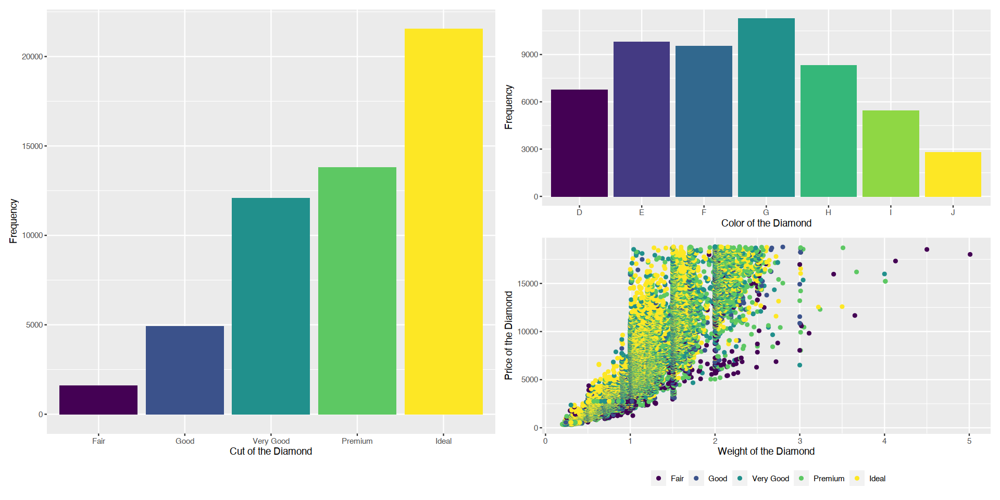

In [11]:
p1 | (p2 / p3)

You get `p1` in one-half of the canvas, and then `p2` and `p3` are split into two rows in the remaining half of the canvas.

What if we wanted to squeeze in the fourth plot?

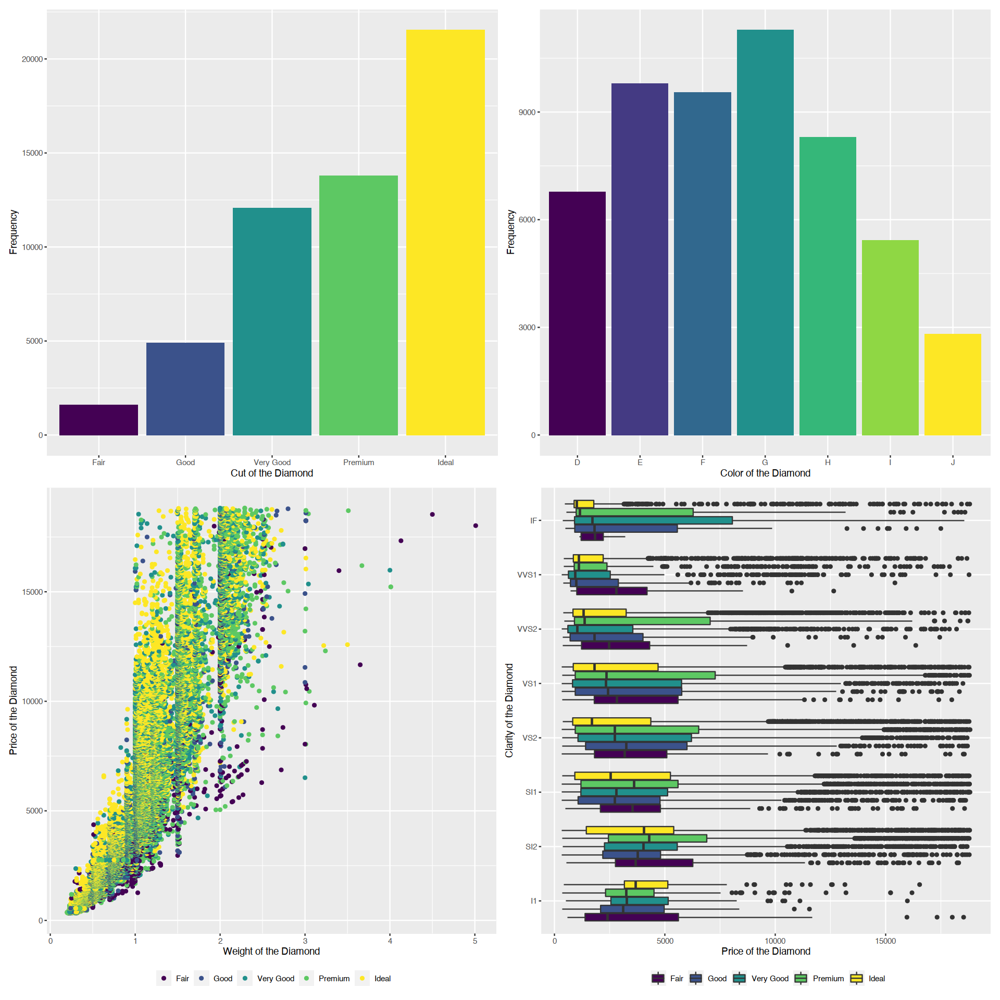

In [12]:
options(repr.plot.width = 16, repr.plot.height = 16)

(p1 + p2) / (p3 + p4)

Here you asked for `p1` and `p2` to be kept together, which led to both occupying the first row of the canvas. Then `p3` and `p4` were slotted into the second row. 

## Annotations 
Annotations become helpful because you can add omnibus titles and tags for individual plots. For example, you can generate a common title, subtitle, caption, etc as shown below). 

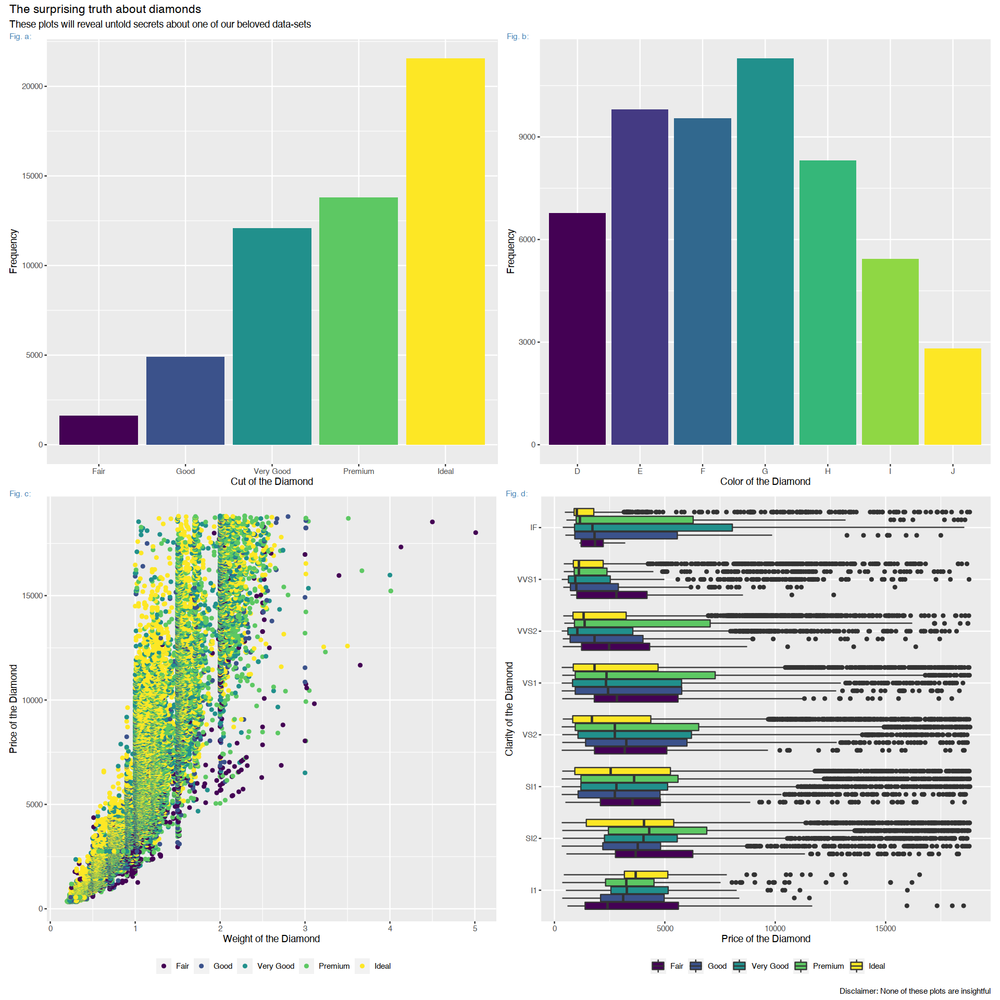

In [13]:
(p1 + p2) / (p3 + p4) +
  plot_annotation(
  title = 'The surprising truth about diamonds',
  subtitle = 'These plots will reveal untold secrets about one of our beloved data-sets',
  caption = 'Disclaimer: None of these plots are insightful',
  tag_levels = c('a', '1'),
  tag_prefix = 'Fig. ',
  tag_sep = '.',
  tag_suffix = ':'
  ) &
  theme(
    plot.tag.position = c(0, 1),
    plot.tag = element_text(size = 9, hjust = 0, vjust = 0, color = "steelblue")
    )

## Spacing and Sizing
We can also tweak the sizes of individual rows and columns, control the space between plots, and so on. First up, spacing the plots with `plot_spacer()` 

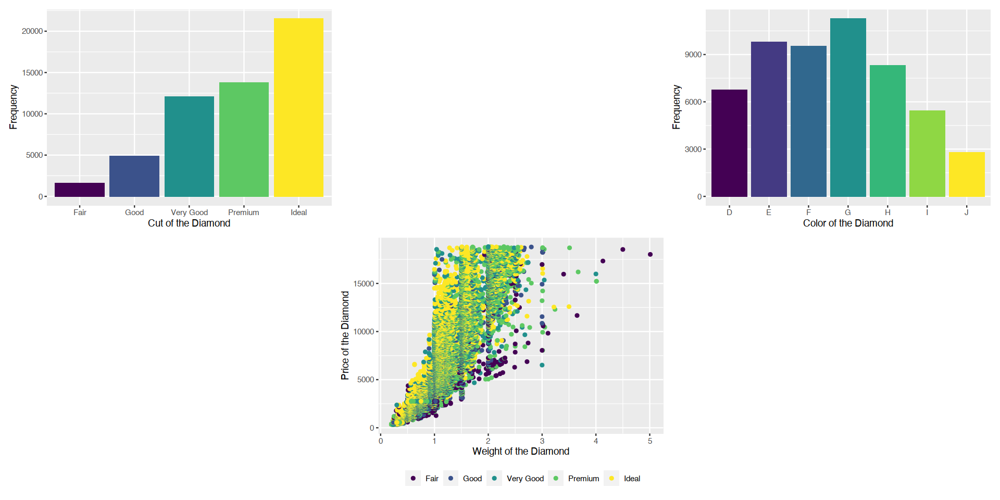

In [14]:
options(repr.plot.width = 16, repr.plot.height = 8)

(p1 + plot_spacer() + p2 + plot_spacer() + p3)

Sizing the plots with relative sizes?

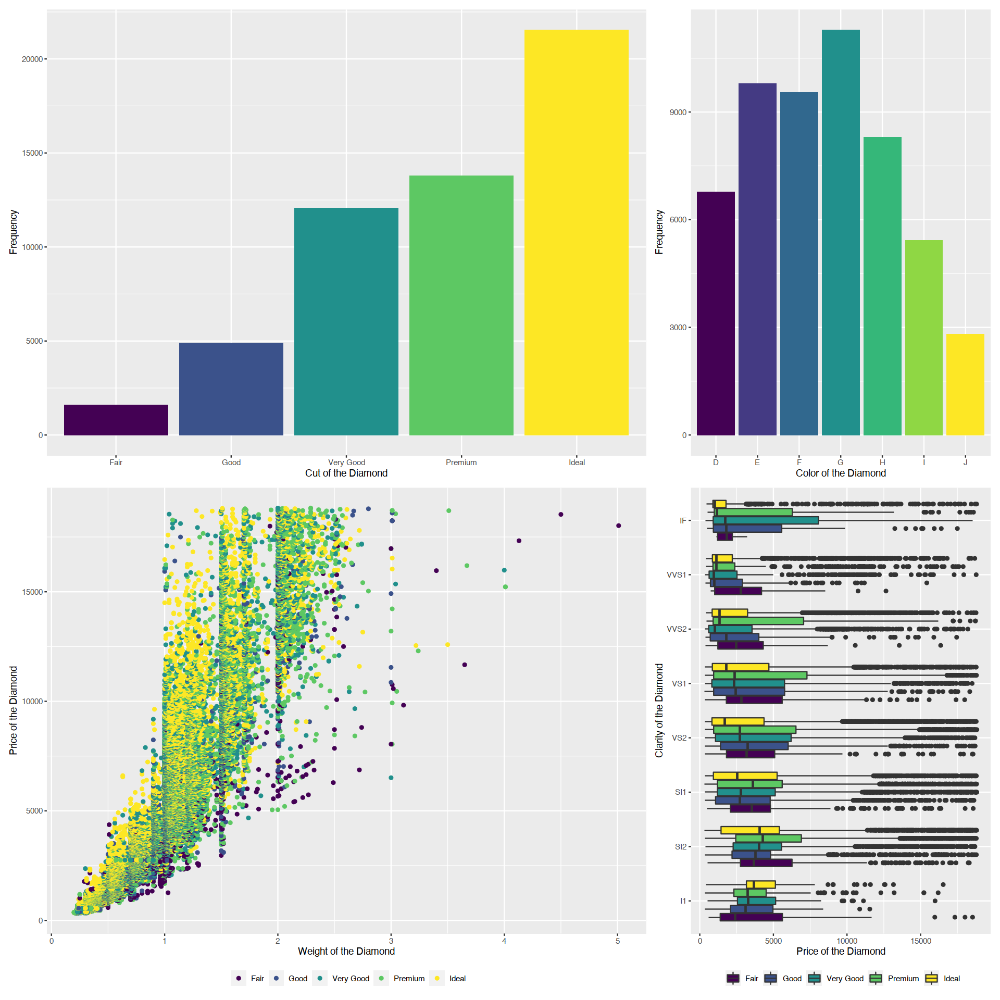

In [15]:
options(repr.plot.width = 16, repr.plot.height = 16)

p1 + p2 + p3 + p4 + 
  plot_layout(widths = c(2, 1))

Alternatively, we could specify size with unit vectors, as shown below. 

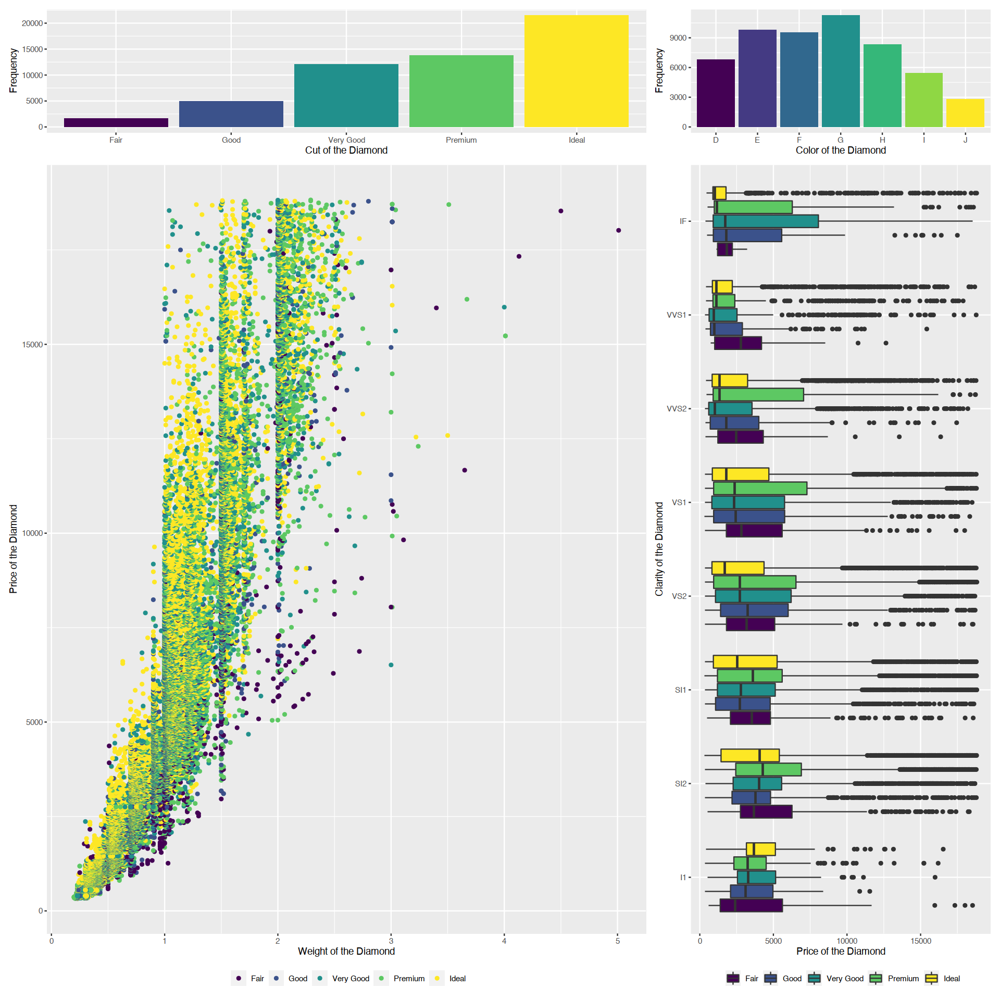

In [16]:
p1 + p2 + p3 + p4 + 
  plot_layout(
    widths = c(2, 1),
    heights = unit(c(5, 1), c('cm', 'null'))
    )

## Moving Beyond the grid

We can use a `layout` design to get a little more flexibility but still retain full control over the result. Layout designs can be done in two ways so let us see the easiest route -- as a text setup. "When using the textual representation it is your responsibility to make sure that each area is rectangular. The only exception is # which denotes empty areas and can thus be of any shape."

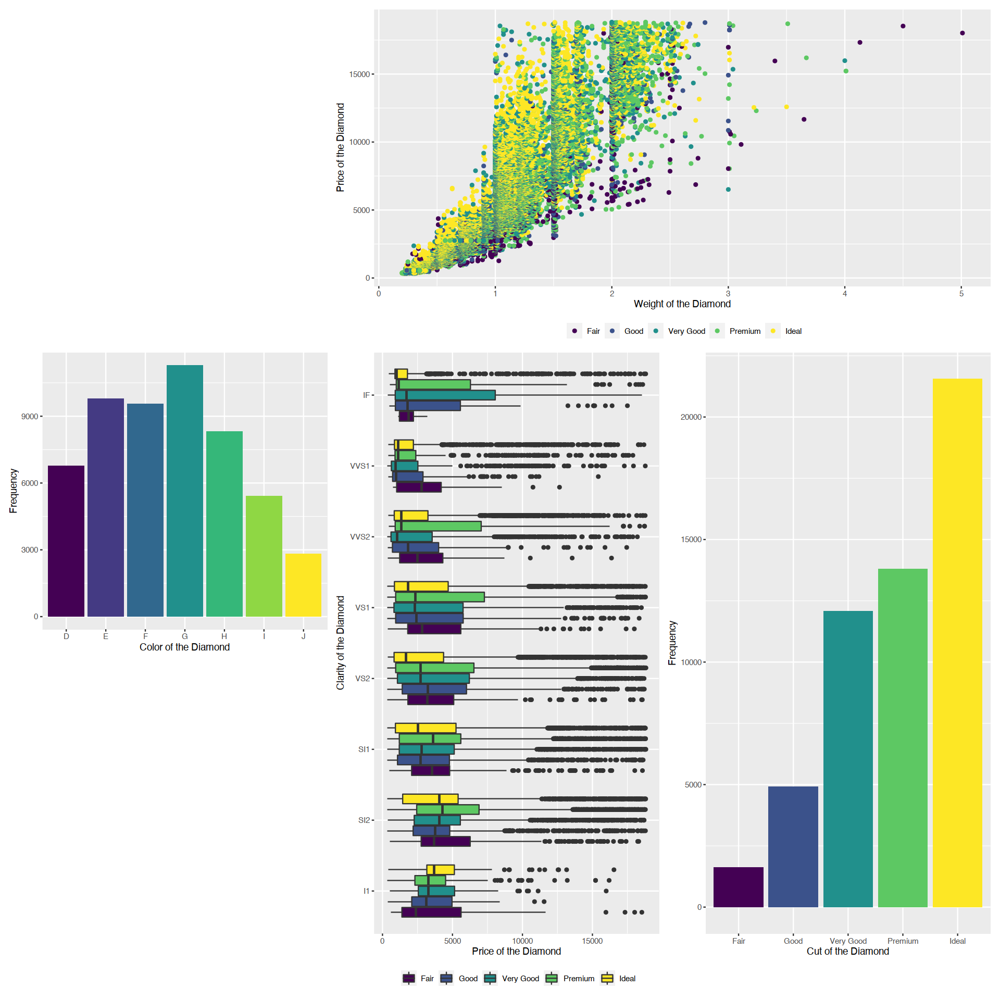

In [17]:
layout <- "
##BBBB
AACCDD
##CCDD
"
p2 + p3 + p4 + p1 + 
  plot_layout(design = layout)

The other path is using `area()` inside `layout`, as shown below. 

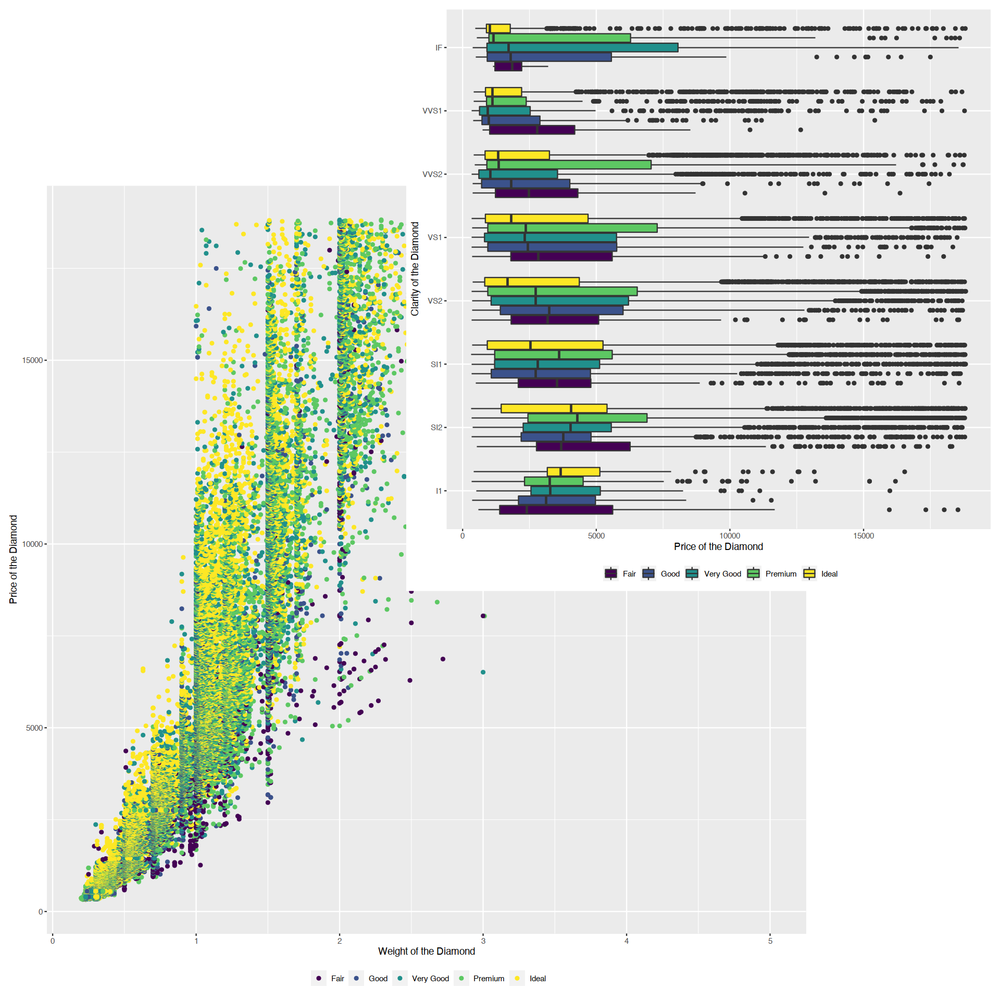

In [18]:
layout <- c(
  area(t = 2, l = 1, b = 5, r = 4),
  area(t = 1, l = 3, b = 3, r = 5)
  )

p3 + p4 + 
  plot_layout(design = layout)

Watch the specification here with `wrap_plots()`

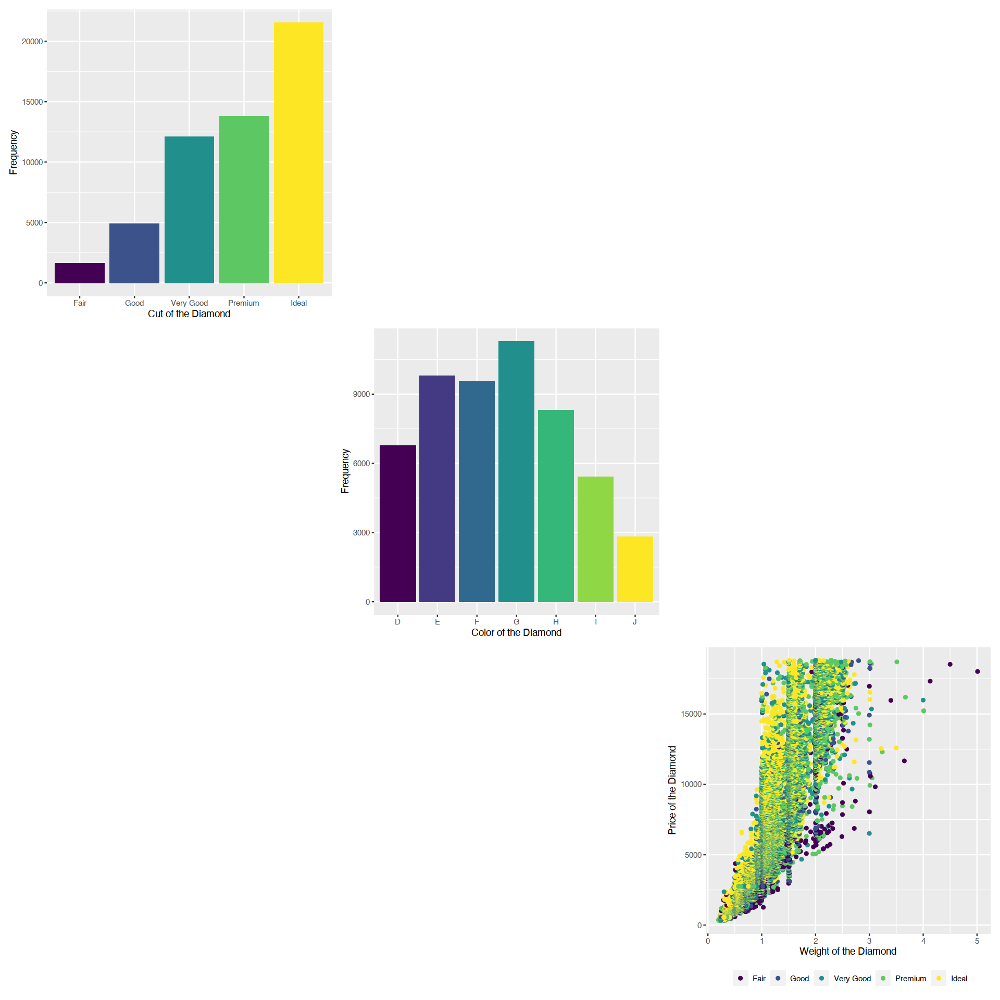

In [19]:
layout <- '
A##
#B#
##C
'
wrap_plots(A = p1, B = p2, C = p3, design = layout)

## Fixed-aspect plots 

There are some plots that use fixed coordinates and these should not be disturbed. Here is an example where the map has fixed coordinates specified via `geom_sf().` What does htis mean? In plain words, this means we should neither stretch nor shrink the map horizontally or vertically because that would distort how it would appear. 

Let us start by loading up the `states.RData` file that has coordinates of all 50 states + Puerto Rico. We will then build a map with the `geom_sf()` command. 

In [20]:
load("data/states.RData")

In [21]:
states %>%
    ggplot() +
    geom_sf(
        aes(fill = estimate)
        ) +
    ggthemes::theme_map() + 
    theme(
        legend.position = "bottom",
        legend.key.width = unit(2, 'cm')
        ) +
    labs(
        title = "Fixed!!",
        fill = "State Population Size"
        ) -> mymap

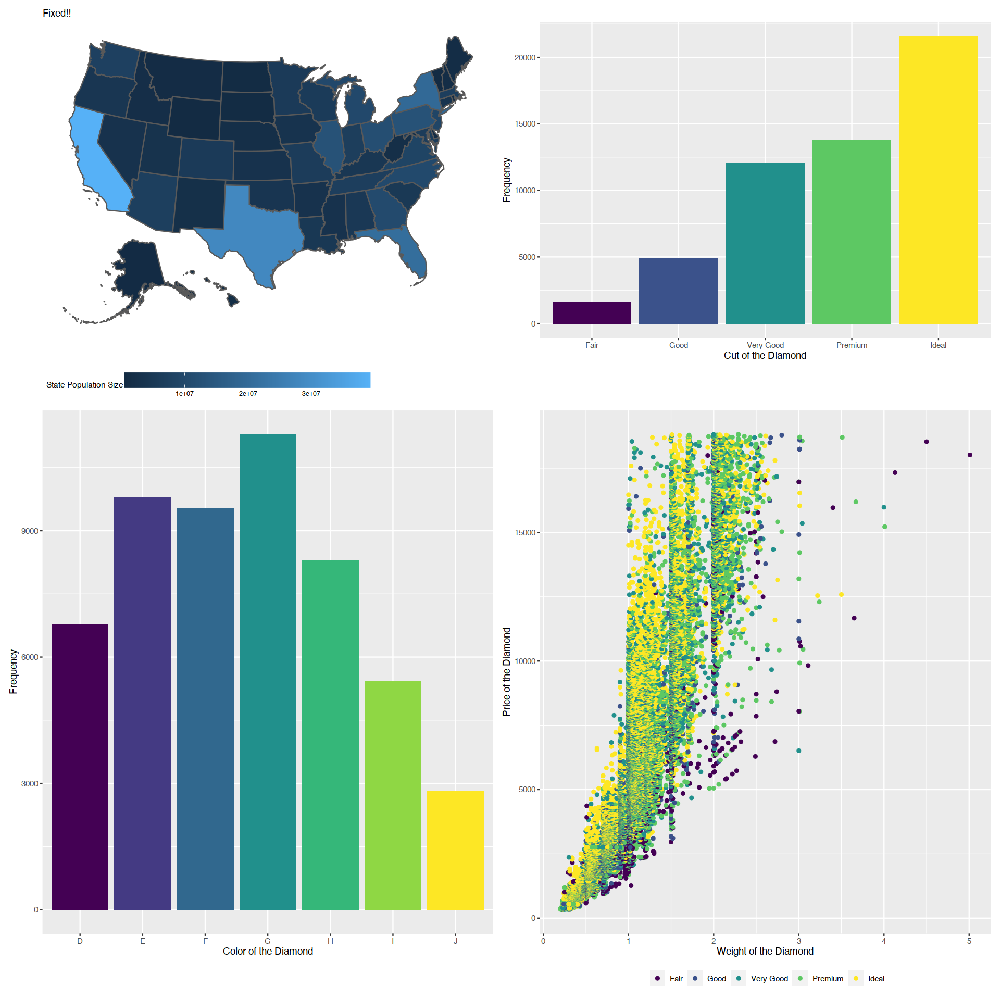

In [22]:
mymap + p1 + p2 + p3

Note that in the next section we will go over the various elements that go into the map. 

# Mapping 

Maps are very powerful visualizations because they allow you to highlight and reflect patterns, clusters, with relative ease. For example, is poverty really higher in Appalachian counties? What about the percent of the population without health insurance? Literacy? Opioid deaths; do they follow transportation routes? What about COVID-19 cases? Maps to the rescue!

Building a map requires a few elements. First and foremost, you need some data to show on a map. Second, you need to have the geographic coordinates needed to build a map, basically the latitude and longitude of the geographies (states, cities, school districts, etc.) that you want to map. Third, you want a column that contains the names of the geographies you want to map, and these should be properly formatted (i.e., in titlecase) for displaying on the map. 

Let us start by building a simple state map. One can build a map in a number of ways i r but we will rely on a simple approach that involves loading up an RData file that has the state boundaries, or then another RData file that has the counties' boundaries.  

In [23]:
load("data/states.RData")

load("data/counties.RData")

In [24]:
glimpse(states)

Rows: 51
Columns: 6
$ GEOID    <chr> "04", "05", "06", "08", "09", "11", "13", "17", "18", "22", "…
$ NAME     <chr> "Arizona", "Arkansas", "California", "Colorado", "Connecticut…
$ variable <chr> "B01001_001", "B01001_001", "B01001_001", "B01001_001", "B010…
$ estimate <dbl> 7050299, 2999370, 39283497, 5610349, 3575074, 692683, 1040384…
$ moe      <dbl> NA, NA, NA, NA, NA, NA, NA, NA, NA, NA, NA, NA, NA, NA, NA, N…
$ geometry <MULTIPOLYGON [m]> MULTIPOLYGON (((-1111066 -8..., MULTIPOLYGON (((…


In [25]:
glimpse(counties)

Rows: 3,142
Columns: 6
$ GEOID    <chr> "01001", "01009", "01017", "01021", "01033", "01045", "01051"…
$ NAME     <chr> "Autauga County, Alabama", "Blount County, Alabama", "Chamber…
$ variable <chr> "B01001_001", "B01001_001", "B01001_001", "B01001_001", "B010…
$ estimate <dbl> 55380, 57681, 33660, 44055, 54771, 49277, 81144, 14809, 33058…
$ moe      <dbl> NA, NA, NA, NA, NA, NA, NA, NA, NA, NA, NA, NA, NA, NA, NA, N…
$ geometry <MULTIPOLYGON [m]> MULTIPOLYGON (((1269841 -13..., MULTIPOLYGON (((…


First, a state map. This is built very simply as shown below. Note that Hawaii and Alaska have been shifted to be visible, that is all. 

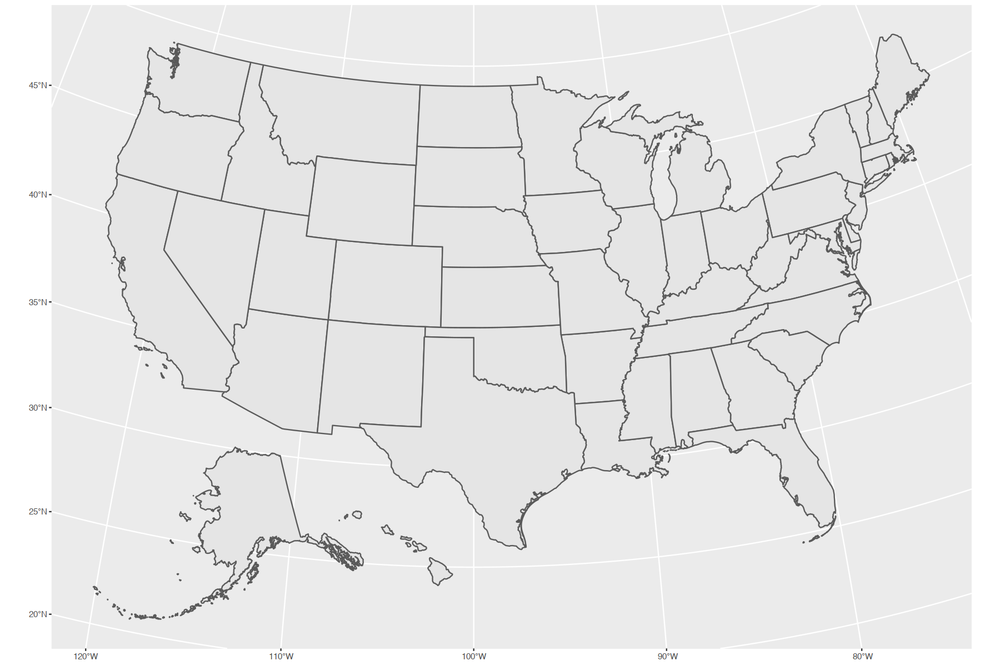

In [26]:
options(repr.plot.width = 15, repr.plot.height = 10)

states %>%
    ggplot() +
    geom_sf()

What if we want the states to be labeled? What if we would like the states to also be filled with a specific color that resembles some value, such as the populatin size, for example? The column `estimate` in the `states.RData` file includes population size. So this should be easy.

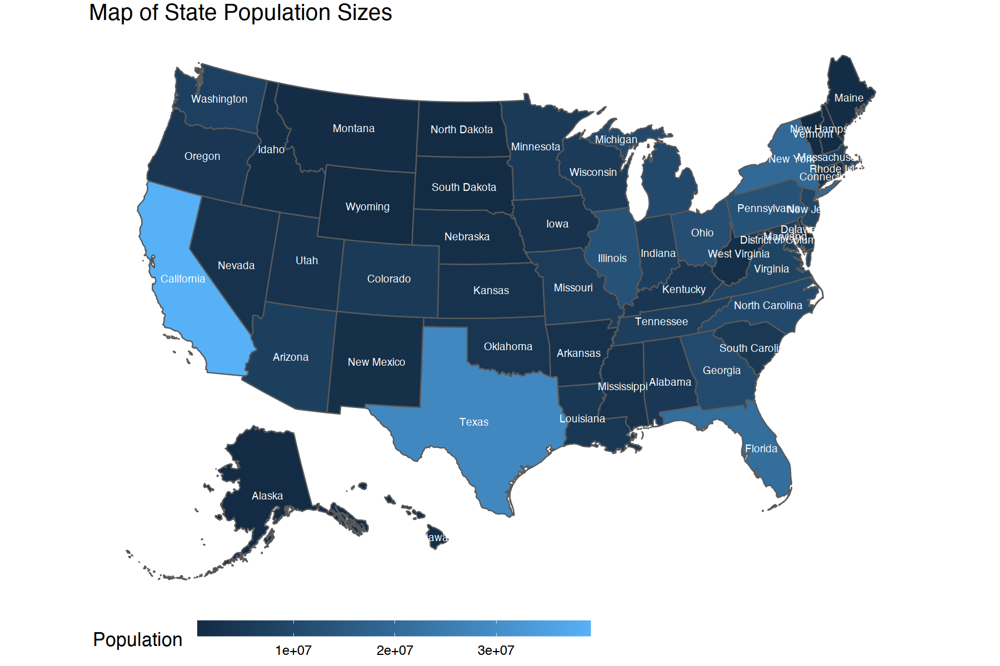

In [27]:
states %>%
    ggplot() +
    geom_sf(
        aes(fill = estimate)
        ) +
    geom_sf_text(
        aes(label = NAME
           ), 
            color = "white"
        ) +
    ggthemes::theme_map() +
    theme(
        legend.position = "bottom",
        legend.text = element_text(size = 14),
        legend.key.width = unit(3, 'cm'),
        title = element_text(size = 20, face = "bold")
        ) +
    labs(
        title = "Map of State Population Sizes",
        fill = "Population")

Note that we have set a white background using `theme_map()` from the `{ggthemes}` package. I have also expanded the fonts and stretched the map legend for readability. 

Again, if you get an error with `ggthemes`, go ahead and install it ONCE via `install.packages("ggthemes")`

What about working with counties instead of states? Sure, let us draw a similar map for all counties. 

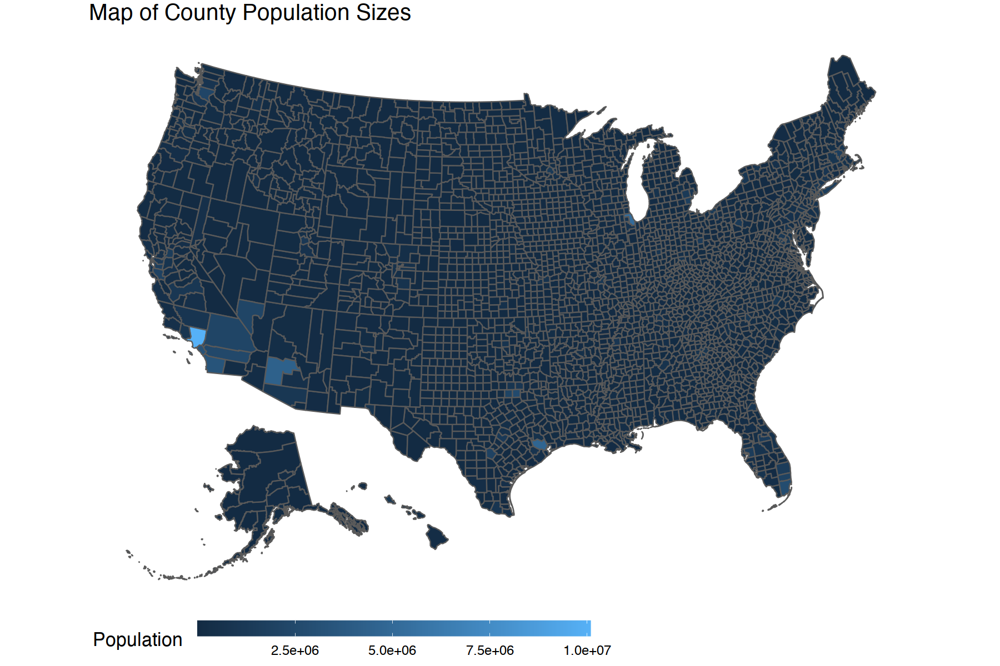

In [28]:
counties %>%
    ggplot() +
    geom_sf(
        aes(fill = estimate)
        ) +
    ggthemes::theme_map() +
    theme(
        legend.position = "bottom",
        legend.text = element_text(size = 14),
        legend.key.width = unit(3, 'cm'),
        title = element_text(size = 20, face = "bold")
        ) +
    labs(
        title = "Map of County Population Sizes",
        fill = "Population")

Maybe you are only interested in Florida?

In [29]:
counties %>%
  filter(grepl("Florida", NAME)) -> florida

filter: removed 3,075 rows (98%), 67 rows remaining



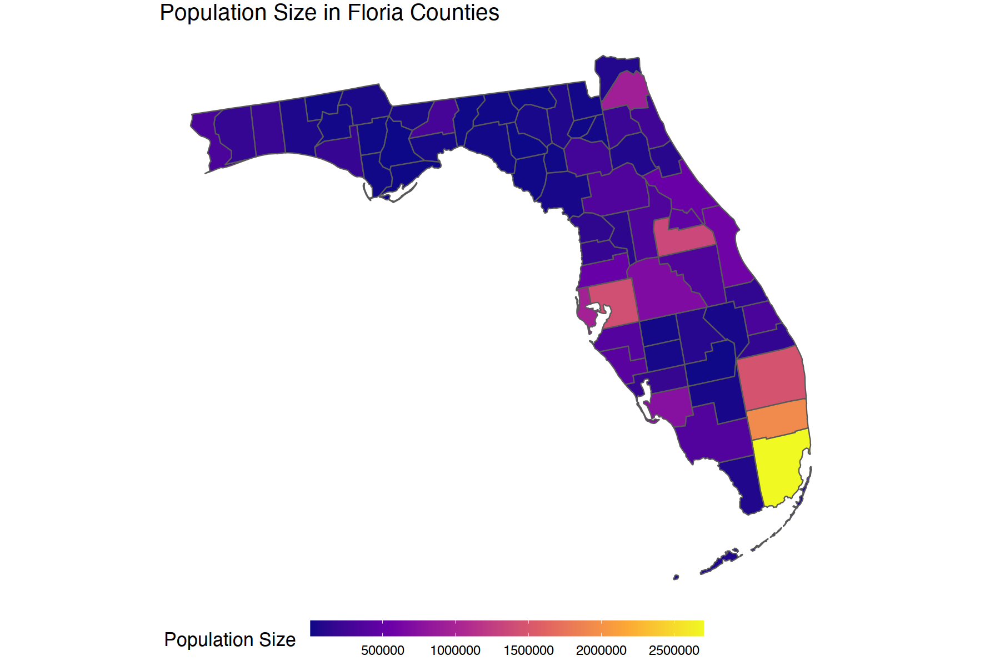

In [30]:
florida %>%
  ggplot() +
  geom_sf(aes(fill = estimate)) +
  ggthemes::theme_map() +
  theme(
      legend.position = "bottom",
      legend.text = element_text(size = 14),
      legend.key.width = unit(3, 'cm'),
      title = element_text(size = 20, face = "bold")
  ) +
  labs(
    title = "Population Size in Floria Counties",
    fill = "Population Size"
        ) +
  scale_fill_viridis_c(option = "plasma")

So far so good but what if we want to fill with some variable that is not in the states or the counties file? This is often the case because you will invariably get the measure you want to map from some other source. For example, what if we want to work with the County Health Rankings file? 

In [31]:
readxl::read_excel(
    "data/CountyHealthRankings2017.xlsx"
    ) -> chr

In [32]:
head(chr)

state,Adult_obesity,Children_in_poverty,Diabetes_monitoring,High_school_graduation,Premature_death,Preventable_hospital_stays,Unemployment_rate
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
AK,0.29,0.15,0.75,0.76,7403.4,35.99,0.06
AL,0.34,0.27,0.85,0.89,9573.2,61.13,0.06
AR,0.34,0.26,0.84,0.85,9150.7,61.95,0.05
AZ,0.26,0.25,0.80,0.78,6787.7,36.97,0.06
CA,0.23,0.21,0.82,NA,5213.2,35.74,0.06
CO,0.20,0.15,0.84,0.77,5711.5,32.09,0.04


Say I want to map Premature death. How would I do that? Well. I will have to find a way to join this `chr` file to the `states` file. 

In `chr` the state column has two-letter codes, but `states` has no such column, and the state names are fully spelled out! 

In [33]:
head(states)

Warning message in fun(libname, pkgname):
“rgeos: versions of GEOS runtime 3.10.1-CAPI-1.16.0
and GEOS at installation 3.9.1-CAPI-1.14.2differ”
Registered S3 method overwritten by 'geojsonsf':
  method        from   
  print.geojson geojson



,GEOID,NAME,variable,estimate,moe,geometry
,<chr>,<chr>,<chr>,<dbl>,<dbl>,<MULTIPOLYGON [m]>
1,04,Arizona,B01001_001,7050299,NA,MULTIPOLYGON (((-1111066 -8...
2,05,Arkansas,B01001_001,2999370,NA,MULTIPOLYGON (((557903.1 -1...
3,06,California,B01001_001,39283497,NA,MULTIPOLYGON (((-1853480 -9...
4,08,Colorado,B01001_001,5610349,NA,MULTIPOLYGON (((-613452.9 -...
5,09,Connecticut,B01001_001,3575074,NA,MULTIPOLYGON (((2226838 519...
6,11,District of Columbia,B01001_001,692683,NA,MULTIPOLYGON (((1960720 -41...


We are in luck. R has various small built-in data, one of which is `state.name` and the other is `state.abb`. If we join these two, we should be able to build a bridge that lets us get where we need to.

In [34]:
state.abb

[1] "AL" "AK" "AZ" "AR" "CA" "CO" "CT" "DE" "FL" "GA" "HI" "ID" "IL" "IN" "IA"
[16] "KS" "KY" "LA" "ME" "MD" "MA" "MI" "MN" "MS" "MO" "MT" "NE" "NV" "NH" "NJ"
[31] "NM" "NY" "NC" "ND" "OH" "OK" "OR" "PA" "RI" "SC" "SD" "TN" "TX" "UT" "VT"
[46] "VA" "WA" "WV" "WI" "WY"

In [35]:
state.name

[1] "Alabama"        "Alaska"         "Arizona"        "Arkansas"      
 [5] "California"     "Colorado"       "Connecticut"    "Delaware"      
 [9] "Florida"        "Georgia"        "Hawaii"         "Idaho"         
[13] "Illinois"       "Indiana"        "Iowa"           "Kansas"        
[17] "Kentucky"       "Louisiana"      "Maine"          "Maryland"      
[21] "Massachusetts"  "Michigan"       "Minnesota"      "Mississippi"   
[25] "Missouri"       "Montana"        "Nebraska"       "Nevada"        
[29] "New Hampshire"  "New Jersey"     "New Mexico"     "New York"      
[33] "North Carolina" "North Dakota"   "Ohio"           "Oklahoma"      
[37] "Oregon"         "Pennsylvania"   "Rhode Island"   "South Carolina"
[41] "South Dakota"   "Tennessee"      "Texas"          "Utah"          
[45] "Vermont"        "Virginia"       "Washington"     "West Virginia" 
[49] "Wisconsin"      "Wyoming"

Now we combine these two files into a single data-se we will call `state_file`

In [36]:
bind_cols(
    state.abb, state.name
    ) -> state_file

colnames(state_file) = c("state", "NAME")

New names:
* NA -> ...1
* NA -> ...2



In [37]:
state_file

state,NAME
<chr>,<chr>
AL,Alabama
AK,Alaska
AZ,Arizona
AR,Arkansas
CA,California
CO,Colorado
CT,Connecticut
DE,Delaware
FL,Florida


I will start with char, and `left_join()` `state_file`

In [38]:
chr %>%
    left_join(
        state_file,
        by = "state"
    ) -> chr_df

left_join: added one column (NAME)

           > rows only in x    1

           > rows only in y  ( 0)

           > matched rows     50

           >                 ====

           > rows total       51



In [39]:
chr_df %>%
    head()

state,Adult_obesity,Children_in_poverty,Diabetes_monitoring,High_school_graduation,Premature_death,Preventable_hospital_stays,Unemployment_rate,NAME
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
AK,0.29,0.15,0.75,0.76,7403.4,35.99,0.06,Alaska
AL,0.34,0.27,0.85,0.89,9573.2,61.13,0.06,Alabama
AR,0.34,0.26,0.84,0.85,9150.7,61.95,0.05,Arkansas
AZ,0.26,0.25,0.80,0.78,6787.7,36.97,0.06,Arizona
CA,0.23,0.21,0.82,NA,5213.2,35.74,0.06,California
CO,0.20,0.15,0.84,0.77,5711.5,32.09,0.04,Colorado


Now we can join the `states` file and map!

In [40]:
states %>% 
    left_join(
        chr_df,
        by = "NAME"
        ) -> chr_states

left_join: added 8 columns (state, Adult_obesity, Children_in_poverty, Diabetes_monitoring, High_school_graduation, …)

           > rows only in x    1

           > rows only in y  ( 1)

           > matched rows     50

           >                 ====

           > rows total       51



In [41]:
head(chr_states)

,GEOID,NAME,variable,estimate,moe,state,Adult_obesity,Children_in_poverty,Diabetes_monitoring,High_school_graduation,Premature_death,Preventable_hospital_stays,Unemployment_rate,geometry
,<chr>,<chr>,<chr>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<MULTIPOLYGON [m]>
1,04,Arizona,B01001_001,7050299,NA,AZ,0.26,0.25,0.80,0.78,6787.7,36.97,0.06,MULTIPOLYGON (((-1111066 -8...
2,05,Arkansas,B01001_001,2999370,NA,AR,0.34,0.26,0.84,0.85,9150.7,61.95,0.05,MULTIPOLYGON (((557903.1 -1...
3,06,California,B01001_001,39283497,NA,CA,0.23,0.21,0.82,NA,5213.2,35.74,0.06,MULTIPOLYGON (((-1853480 -9...
4,08,Colorado,B01001_001,5610349,NA,CO,0.20,0.15,0.84,0.77,5711.5,32.09,0.04,MULTIPOLYGON (((-613452.9 -...
5,09,Connecticut,B01001_001,3575074,NA,CT,0.25,0.15,0.87,0.87,5236.7,46.31,0.06,MULTIPOLYGON (((2226838 519...
6,11,District of Columbia,B01001_001,692683,NA,NA,NA,NA,NA,NA,NA,NA,NA,MULTIPOLYGON (((1960720 -41...


Warning message:
“Removed 1 rows containing missing values (geom_text).”


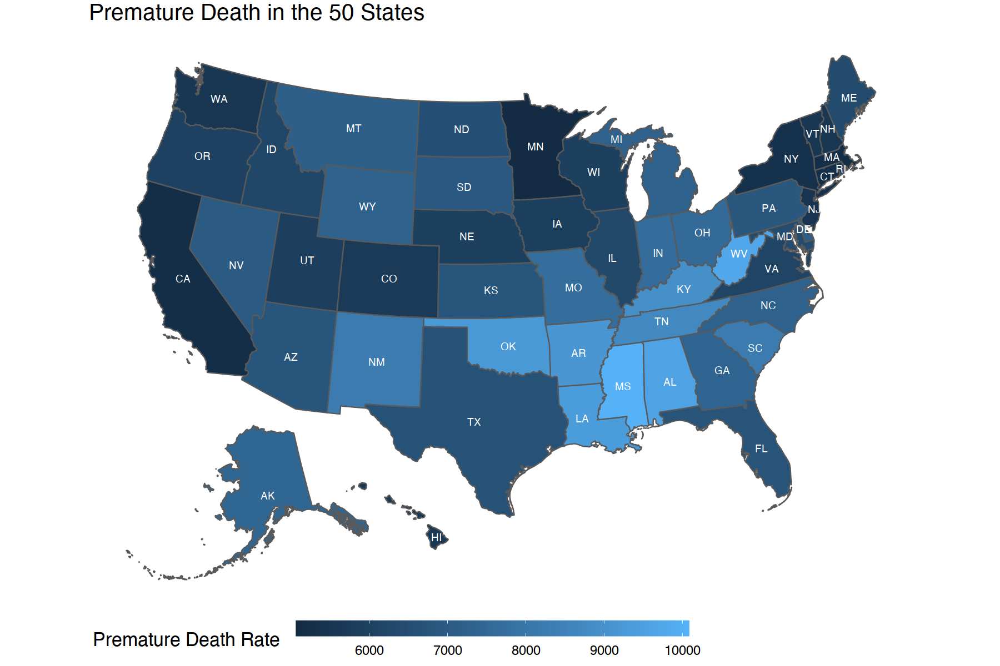

In [42]:
chr_states %>%
    ggplot() +
    geom_sf(
        aes(fill = Premature_death)
        ) +
    geom_sf_text(
        aes(label = state),
        color = "white"
        ) +
    ggthemes::theme_map() +
    theme(
        legend.position = "bottom",
        legend.text = element_text(size = 14),
        legend.key.width = unit(3, 'cm'),
        title = element_text(size = 20, face = "bold")
        ) +
    labs(
        title = "Premature Death in the 50 States",
        fill = "Premature Death Rate"
        ) 

Note the use of `geom_sf_text()` to add the state abbreviations, and I asked for these to be rendered in white rather than the default black font-color. 

You could have also filled by creating quartiles, etc., using `{Santoku}`, so do not forget that option. 

For example, here is the same premature death mapped but instead with the states lumped into quartiles of premature death. 

In [43]:
library(santoku)


Attaching package: ‘santoku’


The following object is masked from ‘package:tidyr’:

    chop




mutate: new variable 'pd_quartiles' (factor) with 5 unique values and 2% NA

Warning message:
“Removed 1 rows containing missing values (geom_text).”


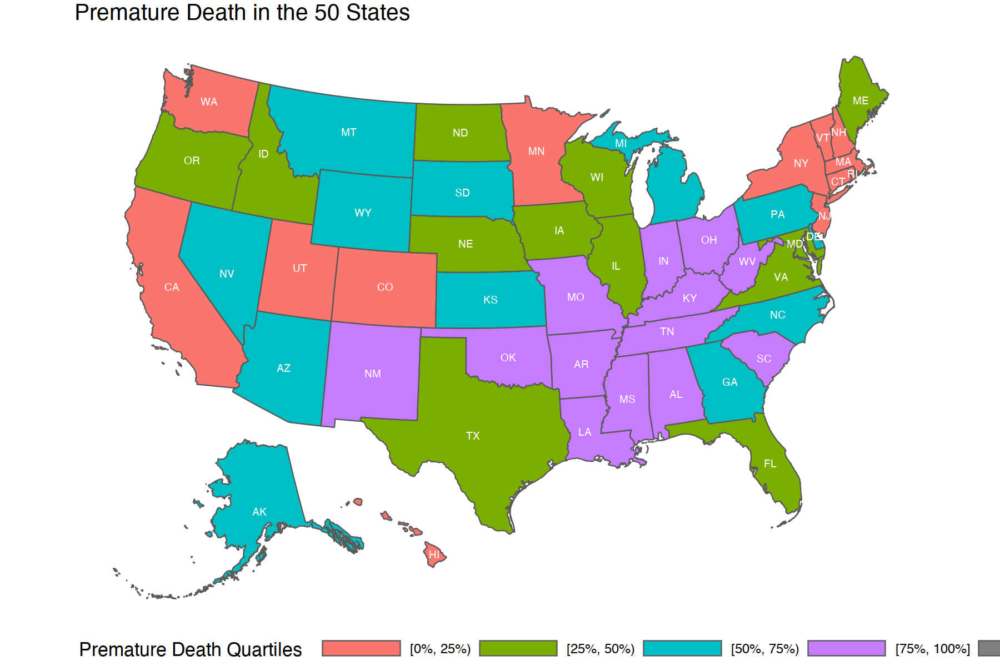

In [44]:
chr_states %>%
    mutate(
        pd_quartiles = chop_equally(Premature_death, groups = 4)
        ) %>% 
    ggplot() +
    geom_sf(
        aes(fill = pd_quartiles)
        ) +
    geom_sf_text(
        aes(label = state),
        color = "white"
        ) +
    ggthemes::theme_map() +
    theme(
        legend.position = "bottom",
        legend.text = element_text(size = 14),
        legend.key.width = unit(3, 'cm'),
        title = element_text(size = 20, face = "bold")
        ) +
    labs(
        title = "Premature Death in the 50 States",
        fill = "Premature Death Quartiles"
        ) 

# Interactive Graphics with Plotly and Highcharter

Interactive graphics are useful in situations where you would like the user/viewer to see the data values or other details by hovering over or clicking on the graphic. Say, for example, I have a scatterplot and want to make it interactive. How can I do that? 

One crude and fast way to do that is by saving my `ggplot2` object and then using `{plotly}` to add a `ggplotly()` wrapper around the plot. 

In the example below I am saving the plot as `pl01`, then wrapping it in `ggplotly` with `ggplotly(pl01) -> lst`. 

In [45]:
install.packages(c("plotly", "highcharter"))

Installing packages into ‘/Library/Frameworks/R.framework/Versions/4.1/Resources/site-library’
(as ‘lib’ is unspecified)




The downloaded binary packages are in
	/tmp/Rtmp3b30pP/downloaded_packages


In [46]:
library(plotly)

ggplot() +
  geom_point(
    data = mpg,
    mapping = aes(
        x = cty, 
        y = hwy, 
        color = trans)
    ) +
  labs(
      x = "City Mileage",
      y = "Highway Mileage",
      color = "Transmission"
  ) -> pl01

lst <- list()

ggplotly(pl01) -> lst

htmltools::tagList(lst)


Attaching package: ‘plotly’


The following objects are masked from ‘package:tidylog’:

    distinct, filter, group_by, mutate, rename, select, slice,
    summarise, transmute, ungroup


The following object is masked from ‘package:ggplot2’:

    last_plot


The following object is masked from ‘package:stats’:

    filter


The following object is masked from ‘package:graphics’:

    layout




Shiny tags cannot be represented in plain text (need html)

These plots are useful when presenting data to a live audience (in a talk, or on the web). 

Rather than use `plotly`, I prefer `{highcharter}` since it does a lot of things well with minimal fuss, and yet the resulting plots are aesthetically pleasing. 

Let us stay with the COVID-19 example. Say I want a bar-chart of the total number of cases by state and want to do this via `highcharter`. 

In [47]:
library(highcharter)

readr::read_csv(
    "https://raw.githubusercontent.com/nytimes/covid-19-data/master/us-counties.csv"
    ) -> covid 

covid %>%
  filter(
      date == "2020-04-17"
  ) %>%
  rename(
      State = state, 
      `Total Cases` = cases
  ) -> tab1

Registered S3 method overwritten by 'quantmod':
  method            from
  as.zoo.data.frame zoo 

Rows: 1956348 Columns: 6

── Column specification ────────────────────────────────────────────────────────
Delimiter: ","
chr  (3): county, state, fips
dbl  (2): cases, deaths
date (1): date


ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.



In [48]:
hchart(
    tab1, 
    "bar", 
    hcaes(
        x = State, 
        y = `Total Cases`
        )
    )

HTML widgets cannot be represented in plain text (need html)

Notice the key elements here: The basic function call is `hchart()` and we are specifying that we want a bar-chart, and we are also providing the quantities that should go on the x and y axis, respectively. Note that x actually ends up as the y when you specify a "bar" chart. 

What if I wanted a line-chart, maybe of the number of cases over time? And I wanted this just for a few states? We could do that too, as shown below. Note that I am creating `tab2`, a frequency table of the number of cases by state and date, and then converting total_cases into a logarithmic form (saved as `log_cases`) so that we can compare the rate of change from one date to the next on a common scale.  

In [49]:
covid %>%
  filter(
      state %in% c("Ohio", "Florida", "California", "New Jersey", "Ohio", "New York"),
      date >= "2020-03-01"
  ) %>%
  group_by(state, date) %>%
  mutate(
      log_cases = log(sum(cases))
  ) %>%
    ungroup() -> tab2

In [50]:
head(tab2)

date,county,state,fips,cases,deaths,log_cases
<date>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>
2020-03-01,Alameda,California,06001,1,0,3.496508
2020-03-01,Humboldt,California,06023,1,0,3.496508
2020-03-01,Los Angeles,California,06037,1,0,3.496508
2020-03-01,Marin,California,06041,1,0,3.496508
2020-03-01,Napa,California,06055,1,0,3.496508
2020-03-01,Orange,California,06059,1,0,3.496508


There are duplicate rows per state per date because the counties remain. I will run `distinct()` to get rid of them.

In [51]:
tab2 %>%
    select(state, date, log_cases) %>%
    distinct() -> tab2_nodups

In [52]:
head(tab2_nodups)

state,date,log_cases
<chr>,<date>,<dbl>
California,2020-03-01,3.4965076
Florida,2020-03-01,0.6931472
New York,2020-03-01,0.0000000
California,2020-03-02,3.6375862
Florida,2020-03-02,0.6931472
New York,2020-03-02,0.0000000


In [53]:
hchart(
    tab2_nodups, 
    "line", 
    hcaes(
        x = date, 
        y = log_cases, 
        group = state
        )
    ) 

HTML widgets cannot be represented in plain text (need html)

Now here is a county-level chart that shows the total number of cases as of November 15, 2021. 

The data are stored in `tab3` created as shown below. Pay attention to this creation because we are not just creating a frequency table but also adding in a specific key we are calling `code` because we will need to join these data to the map data.

In [54]:
covid %>%
  group_by(county, state, fips) %>%
  filter(date == "2021-11-15") %>% 
  unite(
      Location, 
      c(county, state), 
      sep = ", ", 
      remove = TRUE
  ) -> tab3

In [55]:
head(tab3)

date,Location,fips,cases,deaths
<date>,<chr>,<chr>,<dbl>,<dbl>
2021-11-15,"Autauga, Alabama",01001,10407,154
2021-11-15,"Baldwin, Alabama",01003,37875,581
2021-11-15,"Barbour, Alabama",01005,3648,79
2021-11-15,"Bibb, Alabama",01007,4317,92
2021-11-15,"Blount, Alabama",01009,10536,188
2021-11-15,"Bullock, Alabama",01011,1523,44


Here comes the map! 

Note that we are asking forthe `cases` column to be used for the values that will color each county, and we are asking the highcharter map file to be joined with `fips` in the highcharter file and `fips` in `tab3`. 

The county borders will be in steelblue, and there will be 10 values used to create the fill color palette. 

The legend will be aligned right, and set to be horizontal. 

The color palette used will be from the `{viridis}` package.

In [56]:
library(viridis)

hcmap("countries/us/us-all-all", 
      data = tab3,
      name = "COVID-19 Cases", value = "cases",
      joinBy = c("fips", "fips"),
      borderColor = "steelblue"
     ) %>%
  hc_colorAxis(
      stops = color_stops(
          10, 
          rev(magma(10))
          )
      ) %>% 
  hc_legend(
      layout = "horizontal", 
      align = "right",
      floating = TRUE, 
      valueDecimals = 0, 
      valueSuffix = ""
  ) 

Loading required package: viridisLite



HTML widgets cannot be represented in plain text (need html)

Note that `countries/us/us-all-all` indicates that we want counties. If we wanted the states instead it would have been `countries/us/us-all`.  

What if we wanted only Ohio? 

Well, in that case we could subset as shown below. 

In [57]:
tab3 %>%
  filter(
      grepl(", Ohio", Location)
  ) -> tab4

In [58]:
head(tab4)

date,Location,fips,cases,deaths
<date>,<chr>,<chr>,<dbl>,<dbl>
2021-11-15,"Adams, Ohio",39001,4360,105
2021-11-15,"Allen, Ohio",39003,17443,312
2021-11-15,"Ashland, Ohio",39005,7413,146
2021-11-15,"Ashtabula, Ohio",39007,11166,217
2021-11-15,"Athens, Ohio",39009,8083,93
2021-11-15,"Auglaize, Ohio",39011,7334,110


In [59]:
hcmap("countries/us/us-oh-all", 
      data = tab4,
      name = "COVID-19 Cases", value = "cases",
      joinBy = c("fips", "fips"),
      borderColor = "steelblue"
     ) %>%
  hc_colorAxis(
      stops = color_stops(
          10, 
          rev(magma(10))
      )
  ) %>% 
  hc_legend(
      layout = "horizontal", 
      align = "right",
      floating = TRUE, 
      valueDecimals = 0, 
      valueSuffix = ""
  ) 

HTML widgets cannot be represented in plain text (need html)

There you have it! 

The one downside to these interactive charts is that they are best displayed in html files but in PDF and Word document they lose that interactivity. Hence you see them a lot on blogs and other web-based documents. 

All of these packages have been growing so it is quite likely that as software development continues even that barrier might be eliminated.

------------

# Exercises for Practice 

## Exercise 01
Create a map of all the counties in New York. Be sure to title the map and to fill in each county with the total number of COVID19 cases they have seen to date. In addition, draw county borders in white. Use `theme_map()` and make sure the legend is at the bottom. [**Hint:** You will need to calculate the total number of cases per county and then join the resulting file with the counties data file to get the latitude/longitudes for the counties.]

## Exercise 02 
Run the following code chunk to load data on the murder, assault and rape rates per 100,000 persons. `Urbanpop` is the percent of the state population that lives in an urban area. 

In [60]:
library(tidyverse)

data(USArrests)
names(USArrests)
USArrests$statename <- rownames(USArrests)

head(USArrests)

[1] "Murder"   "Assault"  "UrbanPop" "Rape"

,Murder,Assault,UrbanPop,Rape,statename
,<dbl>,<int>,<int>,<dbl>,<chr>
Alabama,13.2,236,58,21.2,Alabama
Alaska,10.0,263,48,44.5,Alaska
Arizona,8.1,294,80,31.0,Arizona
Arkansas,8.8,190,50,19.5,Arkansas
California,9.0,276,91,40.6,California
Colorado,7.9,204,78,38.7,Colorado


Now create a state-level map of the 50 states making sure to use `UrbanPop` to fill each state. Title the map and place the legend at the bottom. 

## Exercise 03

Use the `USArrests` data to draw scatterplots of (a) `Murder` versus `UrbanPop`, (b) `Assault` versus `UrbanPop`, and (c) `Rape` versus `UrbanPop`. Save each of these scatterplots by name and then use `patchwork` to create a single canvas that includes all three plots. Make sure you label the x-axis, y-axis, and title each plot. 

## Exercise 04 

Now create `highcharter` versions of each of the three scatterplots you created in Exercise (3) above. You should end up with three scatterplots, each on its own canvas. 